# Rethinking Spatial Composite Indicators with the Lens of Machine Learning

**Spatial composite indicators** serve as concise performance metrics frequently employed in policy and decision-making contexts. They offer a streamlined depiction of **complex, multi-dimensional
systems** that would otherwise be challenging to grasp visually. 

They are used in various fields and some very famous examples are literacy rate, GDP, social vulnerability index, and air quality index.

However,it’s important to note that spatial composite indicators are 
inherently subjective, as the factors
considered in each indicator are determined by the decision-maker. Theoretically, one can incorporate numerous indicators, and here we would like to explore how it will help us to explore a wider set of alternatives for a given decison problem.

In this notebook, we will see a comprehensive approach for enhancing spatial composite indicators through the dimensional reduction capabilities of machine learning algorithms, particularly self-organizing maps. 

By using a case study on Arctic development, let's see how we can integrate diverse data sources, such as socioeconomic, environmental, and infrastructural datasets, can provide a more holistic perspective on spatial vulnerability and opportunity. 

## 1.   Getting the Decision Factors Ready and Defining the Zone of Interests

In this spatial decision making problem, we will consider various socio-economic , environmental, and infrastructure data which impacts Arctic development in various dimensions.  Below, you can see a table of example data gathered for this case study:

| Factor | Group | Data Source|
|---|---|---|
| Attribute 1 | Socio-economic | www.attribute1.org |
| Attribute 1 | Environmental | www.attribute1.org |
| Attribute 1 | Infrastructure | www.attribute1.org |

Since the location in Artic is very sparse, it would be good to have a fixed zone of interest to measure important statistics, in a way we can summarize the various factors. In this study we will use [H3 hexagons](https://www.uber.com/blog/h3/) (resolution 5) and summarize the decision factors within these hexagons. 

In [8]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import seaborn as sns;sns.set()
from minisom import MiniSom
from sklearn.preprocessing import minmax_scale, scale
import time

Original CRS: EPSG:3995


<AxesSubplot: >

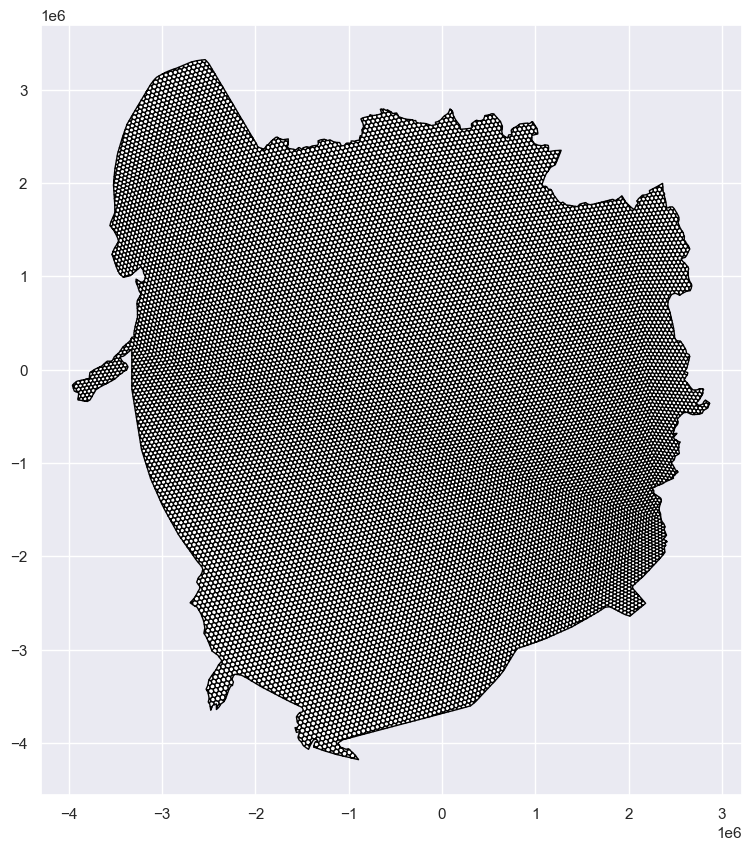

In [9]:
#here we can load the arctic boundary, create the hexagons, and do some zonal statistics with the updated data 
#for the time being I will use the clipped h3 hexagons and then generate random dataset

hexagons = gpd.read_file("clipped_h3_V3.shp")

# Check CRS and reproject if needed
print("Original CRS:", hexagons.crs)
if hexagons.crs != "EPSG:3413":
    hexagons = hexagons.to_crs("EPSG:3413")

# Plot the hexagons
fig, ax = plt.subplots(figsize=(10, 10))

hexagons.plot(ax=ax, facecolor="white", edgecolor="black", linewidth=1)

Run the below code if you would like to create a random dataset, otherwise, skip this and proceed the next cell:

In [3]:
# Set a random seed for reproducibility
#generating random pseudo dataset

np.random.seed(42)

#---------UPDATE THIS SECTION DEPENDING ON YOUR DATASET 
# Define the categories and the number of attributes per category
categories = [
    "demographics", 
    "animal_distribution", 
    "sea_level_rise", 
    "human_mobility", 
    "flood_risk", 
    "energy_infrastructure"
]
attributes_per_category = 10

# Generate random attributes for each category
for category in categories:
    for i in range(1, attributes_per_category + 1):
        col_name = f"{category}_attr{i}"
        # Generate random values (here, uniformly distributed between 0 and 100)
        hexagons[col_name] = np.random.rand(len(hexagons)) * 100


In [10]:

import time
timestr = time.strftime("%Y%m%d-%H%M%S") # this will be used during the output file generation

#---------UPDATE THIS SECTION DEPENDING ON YOUR DATASET 

#Drop any unnecessary attributes' names that won't be useful in SOM
feature_columns = list(hexagons.columns)[4:-1]
feature_names = feature_columns

#Drop any unnecesary attributes that won't be useful in SOM

hex_pdf = hexagons.drop(hexagons.columns[:4],axis=1)
#dropping the gemotry column as well
hex_pdf = hex_pdf.drop(hex_pdf.columns[-1],axis=1)
print(str(len(hex_pdf))+ " features and " +str(len(hex_pdf.columns))+ " columns are added to the dataframe")
hex_pdf.head()


18298 features and 24 columns are added to the dataframe


,AlaskSchoo,Arctic_Edu,Arctic_Hea,Arctic_Hos,Arctic_Inf,CanadUnive,alaskan_ai,CA_geoname,GL_Geoname,Places_P_M,...,gis_osm_pl,ne_10m_rai,ne_10m_roa,gas_pipeli,liquefied_,oil_pipeli,iucn_amphi,iucn_mamma,iucn_plant,iucn_repti
0,0.000000,645820.937500,665141.906250,7.823289e+05,632777.43750,0.0,0.000000,0.0,0.0,0.000000e+00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,1.700672e+09,1.658219e+09,0.000000e+00
1,128621.771635,126571.542969,335910.906250,8.683966e+04,97596.46875,0.0,92401.501202,0.0,0.0,9.063817e+04,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,1.582956e+09,1.597600e+09,0.000000e+00
2,0.000000,582728.312500,761560.406250,1.077625e+06,639285.46875,0.0,0.000000,0.0,0.0,8.086955e+05,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,1.740049e+09,0.000000e+00,0.000000e+00
3,0.000000,34746.707031,69490.335938,6.947173e+04,415502.00000,0.0,0.000000,0.0,0.0,0.000000e+00,...,0.0,0.0,0.0,0.0,0.0,0.0,1.277226e+09,1.318988e+09,1.303496e+09,1.317283e+09
4,0.000000,241825.046875,241814.320312,2.417496e+05,278192.71875,0.0,0.000000,0.0,0.0,1.415046e+06,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,1.740519e+09,1.720378e+09,0.000000e+00


C:\Program Files\ArcGIS\Pro\bin\Python\envs\arcgispro-py3\Lib\site-packages\sklearn\preprocessing\_data.py:258: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(


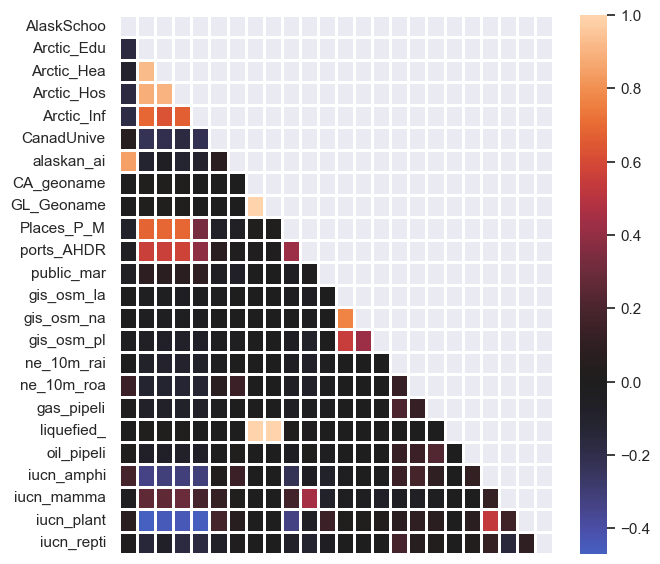

In [11]:
X = hex_pdf[feature_names].values
X = scale(X)

feature_df = pd.DataFrame(X, columns=feature_names)
target = feature_df.iloc[:,0]
Features = feature_df.iloc[:,1:]

corrMatrix = feature_df.corr().round(2)
mask = np.zeros_like(corrMatrix)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("darkgrid"):
    f, ax = plt.subplots(figsize=(7, 7))
    ax = sns.heatmap(corrMatrix, mask=mask,center=0, linewidths=1, xticklabels=False)

plt.show()

In [12]:
#if you want to provide a differen X now, that is the time! X=hex_pdf[feature_names].values

#SOM Parameters

size = 14 #size of the Unified Matrix
hc_function = 'gaussian'
kernel_width = 1
rnd_seed = 1
training_epoch = 100000

In [13]:
som = MiniSom(size, size, len(X[0]),
              neighborhood_function=hc_function, sigma=kernel_width,
              random_seed=rnd_seed)

som.pca_weights_init(X)
som.train_random(X, training_epoch, verbose=True)

C:\Program Files\ArcGIS\Pro\bin\Python\envs\arcgispro-py3\Lib\site-packages\minisom.py:447: ComplexWarning: Casting complex values to real discards the imaginary part
  self._weights[i, j] = c1*pc[pc_order[0]] + \


 [   3247 / 100000 ]   3% - 0:00:06 left 

 [   6278 / 100000 ]   6% - 0:00:06 left 

 [   9441 / 100000 ]   9% - 0:00:05 left 

 [  12827 / 100000 ]  13% - 0:00:05 left 

 [  16056 / 100000 ]  16% - 0:00:05 left 

 [  18917 / 100000 ]  19% - 0:00:05 left 

 [  22077 / 100000 ]  22% - 0:00:05 left 

 [  25334 / 100000 ]  25% - 0:00:04 left 

 [  28494 / 100000 ]  28% - 0:00:04 left 

 [  31848 / 100000 ]  32% - 0:00:04 left 

 [  34870 / 100000 ]  35% - 0:00:04 left 

 [  37817 / 100000 ]  38% - 0:00:04 left 

 [  40923 / 100000 ]  41% - 0:00:03 left 

 [  44324 / 100000 ]  44% - 0:00:03 left 

 [  47407 / 100000 ]  47% - 0:00:03 left 

 [  50509 / 100000 ]  51% - 0:00:03 left 

 [  53604 / 100000 ]  54% - 0:00:03 left 

 [  56605 / 100000 ]  57% - 0:00:02 left 

 [  59740 / 100000 ]  60% - 0:00:02 left 

 [  62734 / 100000 ]  63% - 0:00:02 left 

 [  65567 / 100000 ]  66% - 0:00:02 left 

 [  68555 / 100000 ]  69% - 0:00:02 left 

 [  71417 / 100000 ]  71% - 0:00:01 left 

 [  74534 / 100000 ]  75% - 0:00:01 left 

 [  77586 / 100000 ]  78% - 0:00:01 left 

 [  80986 / 100000 ]  81% - 0:00:01 left 

 [  83995 / 100000 ]  84% - 0:00:01 left 

 [  87081 / 100000 ]  87% - 0:00:00 left 

 [  90240 / 100000 ]  90% - 0:00:00 left 

 [  93484 / 100000 ]  93% - 0:00:00 left 

 [  96743 / 100000 ]  97% - 0:00:00 left 

 [  99953 / 100000 ] 100% - 0:00:00 left 

 [ 100000 / 100000 ] 100% - 0:00:00 left 
 quantization error: 0.9880528934984502


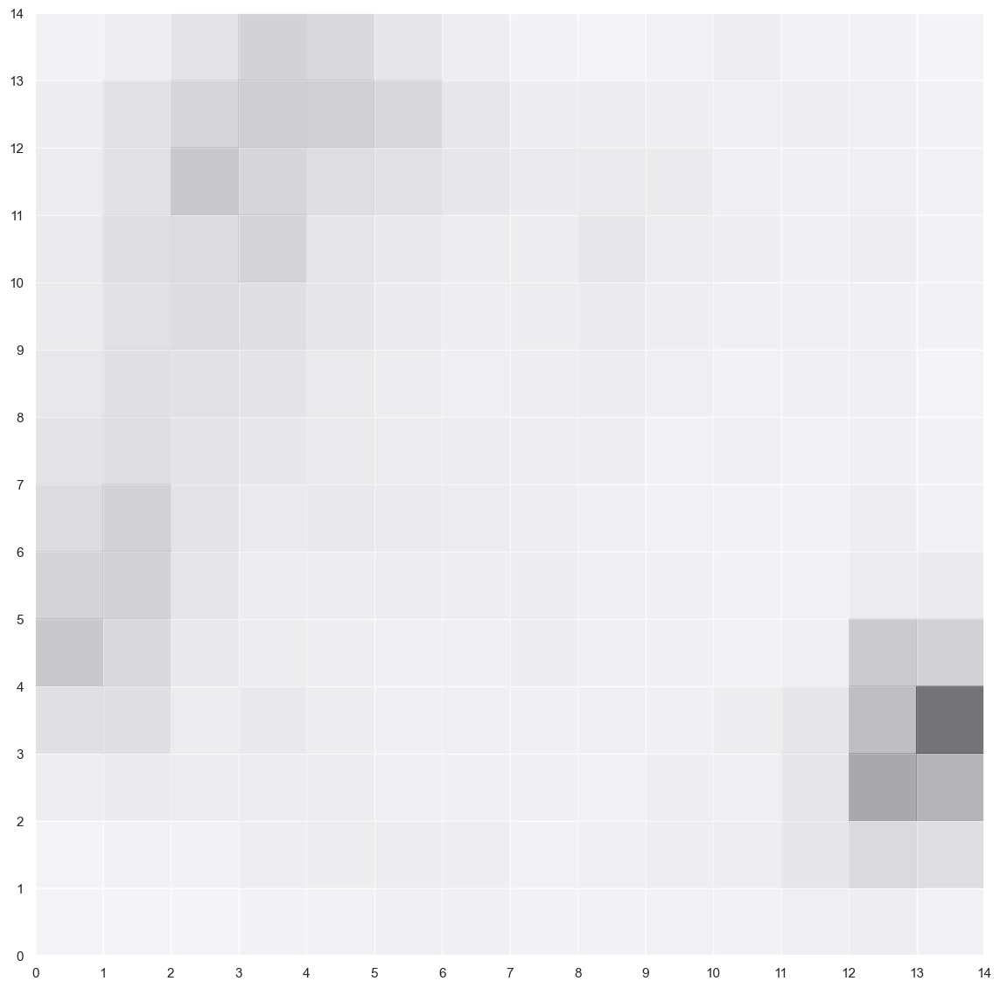

In [14]:
SOM_indicies_map = som.labels_map(X, hex_pdf.index +1) #  

plt.figure(figsize=(14, 14))
for p, features in SOM_indicies_map.items():
    features = list(features)
    x = p[0] + .1
    y = p[1] - .3
    for i, c in enumerate(features):
        off_set = (i+1)/len(features) - 0.05
plt.pcolor(som.distance_map().T, cmap='gray_r', alpha=.5)
plt.xticks(np.arange(size+1))
plt.yticks(np.arange(size+1))
plt.grid()

plt.savefig("UMaxtrix_vector_"+str(timestr)+".svg", bbox_inches='tight', dpi=300)

plt.show()

C:\Users\ssalapay\AppData\Local\Temp\ipykernel_40384\3099756405.py:13: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "o" (-> marker='o'). The keyword argument will take precedence.
  plt.plot([j+.5], [i+.5], 'o',


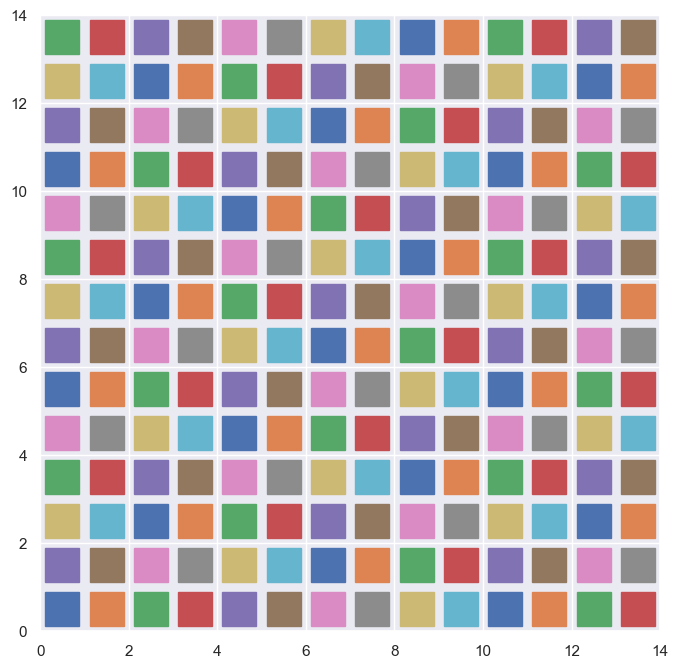

In [16]:
W= som.get_weights()
Z = np.zeros((size, size))
plt.figure(figsize=(8, 8))

clusterarray={}
color_hex =["#a6cee3","#1f78b4","#b2df8a","#33a02c","#fb9a99","#e31a1c","#fdbf6f","#ff7f00","#cab2d6","#6a3d9a",'#8dd3c7']
#color_hex= ['#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69','#fccde5','#d9d9d9','#bc80bd']
#"tab20c" #"tab20b"
for i in np.arange(som._weights.shape[0]):
    for j in np.arange(som._weights.shape[1]):
        feature = np.argmax(W[i, j , :])
        clusterarray[i,j]=feature
        plt.plot([j+.5], [i+.5], 'o',
                 marker='s', markersize=24)

#legend_elements = [Patch(facecolor=color_hex[i],
#                         edgecolor='w',
#                         label=f) for i, f in enumerate(feature_names)]
legendlabels=[]

        
plt.xlim([0, size])
plt.ylim([0, size])
plt.savefig("clusters_vector_"+str(timestr)+".svg", bbox_inches='tight', dpi=300)
plt.show()

In [17]:
cluster_xy_dic = pd.DataFrame(list(clusterarray.items()),columns=['UM_Location','ClusterID'])
cluster_xy_dic


,UM_Location,ClusterID
0,"(0, 0)",20
1,"(0, 1)",20
2,"(0, 2)",20
3,"(0, 3)",17
4,"(0, 4)",17
...,...,...
191,"(13, 9)",4
192,"(13, 10)",4
193,"(13, 11)",4
194,"(13, 12)",4


In [18]:
cluster_xy_dic["ClusterID"].nunique()

22

In [19]:
feature_xy_dic = pd.DataFrame(list(SOM_indicies_map.items()),columns=['UM_Location','Features'])
feature_xy_dic

,UM_Location,Features
0,"(0, 13)","{1: 1, 28: 1, 82: 1, 314: 1, 405: 1, 553: 1, 5..."
1,"(9, 2)","{2: 1, 46: 1, 180: 1, 203: 1, 232: 1, 363: 1, ..."
2,"(12, 11)","{3: 1, 318: 1, 881: 1, 1368: 1, 2131: 1, 2690:..."
3,"(2, 7)","{4: 1, 14: 1, 135: 1, 258: 1, 281: 1, 427: 1, ..."
4,"(9, 1)","{5: 1, 569: 1, 655: 1, 1275: 1, 1290: 1, 1496:..."
...,...,...
183,"(1, 5)","{2051: 1, 2714: 1, 4129: 1, 5410: 1, 5716: 1, ..."
184,"(0, 5)","{2250: 1, 2566: 1, 5024: 1, 5893: 1, 7729: 1, ..."
185,"(0, 3)","{2518: 1, 2560: 1, 3423: 1, 3482: 1, 4139: 1, ..."
186,"(5, 7)","{3027: 1, 3498: 1, 4381: 1, 4450: 1, 4545: 1, ..."


In [20]:
joined = pd.merge(cluster_xy_dic,feature_xy_dic)
joined

,UM_Location,ClusterID,Features
0,"(0, 0)",20,"{145: 1, 164: 1, 224: 1, 312: 1, 319: 1, 392: ..."
1,"(0, 1)",20,"{78: 1, 153: 1, 263: 1, 375: 1, 479: 1, 596: 1..."
2,"(0, 2)",20,"{360: 1, 682: 1, 822: 1, 967: 1, 1144: 1, 1276..."
3,"(0, 3)",17,"{2518: 1, 2560: 1, 3423: 1, 3482: 1, 4139: 1, ..."
4,"(0, 4)",17,"{540: 1, 556: 1, 650: 1, 2556: 1, 4267: 1, 449..."
...,...,...,...
183,"(13, 9)",4,"{26: 1, 102: 1, 110: 1, 554: 1, 570: 1, 612: 1..."
184,"(13, 10)",4,"{563: 1, 634: 1, 733: 1, 1097: 1, 1131: 1, 114..."
185,"(13, 11)",4,"{123: 1, 219: 1, 301: 1, 663: 1, 701: 1, 833: ..."
186,"(13, 12)",4,"{116: 1, 213: 1, 350: 1, 531: 1, 662: 1, 885: ..."


In [21]:
split_df = pd.DataFrame(joined['Features'].tolist())
df = pd.concat([joined, split_df], axis=1)
df

,UM_Location,ClusterID,Features,145,164,224,312,319,392,524,...,17316,17455,17704,17705,17725,17800,17868,17951,17971,18285
0,"(0, 0)",20,"{145: 1, 164: 1, 224: 1, 312: 1, 319: 1, 392: ...",1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"(0, 1)",20,"{78: 1, 153: 1, 263: 1, 375: 1, 479: 1, 596: 1...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"(0, 2)",20,"{360: 1, 682: 1, 822: 1, 967: 1, 1144: 1, 1276...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"(0, 3)",17,"{2518: 1, 2560: 1, 3423: 1, 3482: 1, 4139: 1, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"(0, 4)",17,"{540: 1, 556: 1, 650: 1, 2556: 1, 4267: 1, 449...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183,"(13, 9)",4,"{26: 1, 102: 1, 110: 1, 554: 1, 570: 1, 612: 1...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
184,"(13, 10)",4,"{563: 1, 634: 1, 733: 1, 1097: 1, 1131: 1, 114...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
185,"(13, 11)",4,"{123: 1, 219: 1, 301: 1, 663: 1, 701: 1, 833: ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186,"(13, 12)",4,"{116: 1, 213: 1, 350: 1, 531: 1, 662: 1, 885: ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
rows=[]
featurecodes=hex_pdf.index +1  #if that is something different than the OID replace this!

for feature in featurecodes:
    clusterID = df.loc[df[feature] == 1.0, 'ClusterID'].iloc[0]
    row = [feature,clusterID]
    rows.append(row)

thematic_df = pd.DataFrame(rows,columns=["Feature","ClusterID"])
thematic_df["ClusterID"]=thematic_df["ClusterID"]+1
thematic_df

,Feature,ClusterID
0,1,12
1,2,1
2,3,4
3,4,24
4,5,10
...,...,...
18293,18294,21
18294,18295,1
18295,18296,23
18296,18297,2


# Spatialization

In [23]:
import geopandas as gpd
hexagons.head()
hexagons ["OID"]=hexagons.index+1
hexagons.head()

,GRID_ID,Shape_Leng,Shape_Area,AlaskPoint,AlaskSchoo,Arctic_Edu,Arctic_Hea,Arctic_Hos,Arctic_Inf,CanadUnive,...,ne_10m_roa,gas_pipeli,liquefied_,oil_pipeli,iucn_amphi,iucn_mamma,iucn_plant,iucn_repti,geometry,OID
0,84079d5ffffffff,153247.601575,1.691705e+09,0.0,0.000000,645820.937500,665141.906250,7.823289e+05,632777.43750,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,1.700672e+09,1.658219e+09,0.000000e+00,"POLYGON ((250753.583 -1426069.147, 233697.299 ...",1
1,840cec7ffffffff,152946.188276,1.679672e+09,0.0,128621.771635,126571.542969,335910.906250,8.683966e+04,97596.46875,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,1.582956e+09,1.597600e+09,0.000000e+00,"POLYGON ((-3274450.482 1207583.731, -3291429.5...",2
2,840215dffffffff,155474.834454,1.742263e+09,0.0,0.000000,582728.312500,761560.406250,1.077625e+06,639285.46875,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,1.740049e+09,0.000000e+00,0.000000e+00,"POLYGON ((-1115665.111 -311843.678, -1109794.6...",3
3,840ee87ffffffff,170892.868946,1.955522e+09,0.0,0.000000,34746.707031,69490.335938,6.947173e+04,415502.00000,0.0,...,0.0,0.0,0.0,0.0,1.277226e+09,1.318988e+09,1.303496e+09,1.317283e+09,"POLYGON ((-2344663.192 -3543083.172, -2340689....",4
4,84034c7ffffffff,156040.544254,1.755119e+09,0.0,0.000000,241825.046875,241814.320312,2.417496e+05,278192.71875,0.0,...,0.0,0.0,0.0,0.0,0.000000e+00,1.740519e+09,1.720378e+09,0.000000e+00,"POLYGON ((-300451.221 -1166328.713, -293458.28...",5


In [24]:
df = hexagons.merge(thematic_df, left_on='OID', right_on='Feature' , how='left')
gdf =gpd.GeoDataFrame(df)
gdf.head()

,GRID_ID,Shape_Leng,Shape_Area,AlaskPoint,AlaskSchoo,Arctic_Edu,Arctic_Hea,Arctic_Hos,Arctic_Inf,CanadUnive,...,liquefied_,oil_pipeli,iucn_amphi,iucn_mamma,iucn_plant,iucn_repti,geometry,OID,Feature,ClusterID
0,84079d5ffffffff,153247.601575,1.691705e+09,0.0,0.000000,645820.937500,665141.906250,7.823289e+05,632777.43750,0.0,...,0.0,0.0,0.000000e+00,1.700672e+09,1.658219e+09,0.000000e+00,"POLYGON ((250753.583 -1426069.147, 233697.299 ...",1,1,12
1,840cec7ffffffff,152946.188276,1.679672e+09,0.0,128621.771635,126571.542969,335910.906250,8.683966e+04,97596.46875,0.0,...,0.0,0.0,0.000000e+00,1.582956e+09,1.597600e+09,0.000000e+00,"POLYGON ((-3274450.482 1207583.731, -3291429.5...",2,2,1
2,840215dffffffff,155474.834454,1.742263e+09,0.0,0.000000,582728.312500,761560.406250,1.077625e+06,639285.46875,0.0,...,0.0,0.0,0.000000e+00,1.740049e+09,0.000000e+00,0.000000e+00,"POLYGON ((-1115665.111 -311843.678, -1109794.6...",3,3,4
3,840ee87ffffffff,170892.868946,1.955522e+09,0.0,0.000000,34746.707031,69490.335938,6.947173e+04,415502.00000,0.0,...,0.0,0.0,1.277226e+09,1.318988e+09,1.303496e+09,1.317283e+09,"POLYGON ((-2344663.192 -3543083.172, -2340689....",4,4,24
4,84034c7ffffffff,156040.544254,1.755119e+09,0.0,0.000000,241825.046875,241814.320312,2.417496e+05,278192.71875,0.0,...,0.0,0.0,0.000000e+00,1.740519e+09,1.720378e+09,0.000000e+00,"POLYGON ((-300451.221 -1166328.713, -293458.28...",5,5,10


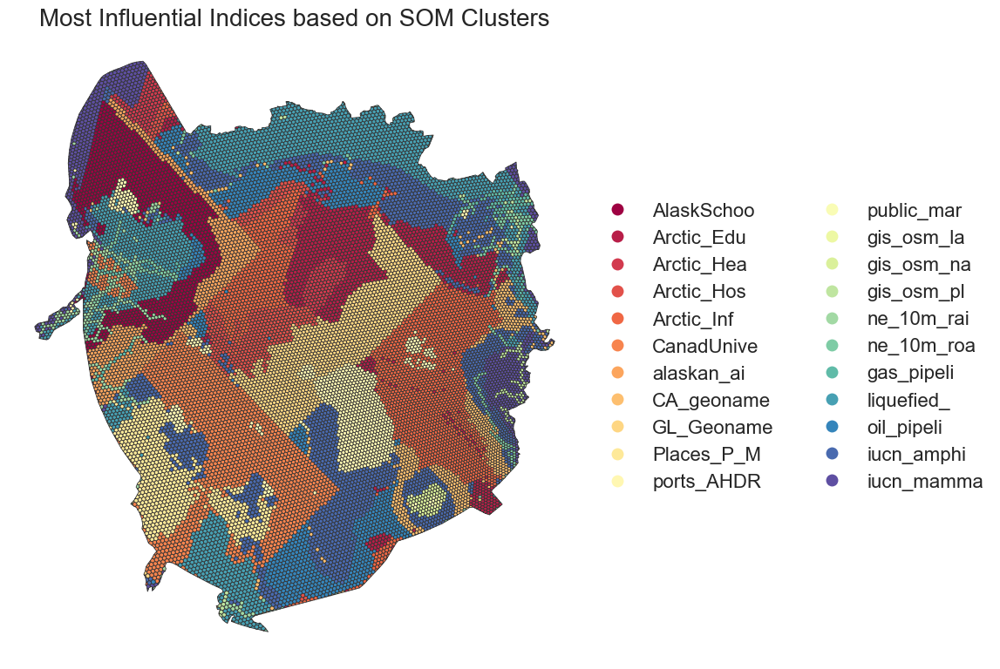

In [25]:
num_clusters = gdf['ClusterID'].nunique()
ncol = 2 if num_clusters > 10 else 1

# Step 1: Map ClusterID to feature names
cluster_to_feature = dict(zip(gdf['ClusterID'].unique(), feature_names))

# Step 2: Plot the map
fig, ax = plt.subplots(1, figsize=(14, 8))

gdf.plot(
    column='ClusterID', 
    categorical=True, 
    cmap='Spectral', 
    linewidth=0.6, 
    edgecolor='0.2',
    legend=True, 
    legend_kwds={
        'loc': 'center left',
        'bbox_to_anchor': (1, 0.5),
        'fontsize': 16,
        'frameon': False,
        'ncol': ncol,
        # Update legend labels with feature names corresponding to ClusterID
        'labels': [cluster_to_feature[cluster] for cluster in gdf['ClusterID'].unique()]
    }, 
    ax=ax
)

ax.axis('off')
ax.set_title('Most Influential Indices based on SOM Clusters', fontsize=20)
plt.tight_layout()
plt.subplots_adjust(right=0.85)
plt.show()


If you have more than 10 classes, having an interactive visual would be easier to interpret:

In [26]:
pip install bokeh

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [27]:
import geopandas as gpd
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models import (
    GeoJSONDataSource, HoverTool, CategoricalColorMapper
)
from bokeh.palettes import Category20_20
import json

output_notebook()

# Step 1: Prepare GeoDataFrame
gdf_bokeh = gdf.copy()
gdf_bokeh['ClusterID'] = gdf_bokeh['ClusterID'].astype(str)  # Convert to string for color mapping
gdf_bokeh['FeatureName'] = gdf_bokeh['ClusterID'].map(lambda cid: cluster_to_feature[int(cid)])

# Step 2: Convert to GeoJSON
geojson_data = json.loads(gdf_bokeh.to_json())
geo_source = GeoJSONDataSource(geojson=json.dumps(geojson_data))

# Step 3: Setup color mapper
cluster_ids = list(gdf_bokeh['ClusterID'].unique())
palette = Category20_20[:len(cluster_ids)]  # Use first N colors
color_mapper = CategoricalColorMapper(factors=cluster_ids, palette=palette)

# Step 4: Plot
p = figure(
    title="SOM Clusters (Arctic View)",
    width=950, height=750,
    match_aspect=True,
    tools="pan,wheel_zoom,reset,hover,save",
)

p.patches('xs', 'ys', source=geo_source,
          fill_alpha=0.8,
          fill_color={'field': 'ClusterID', 'transform': color_mapper},
          line_color='black',
          line_width=0.3)

# Step 5: Hover tool
hover = p.select_one(HoverTool)
hover.tooltips = [
    ("Cluster ID", "@ClusterID"),
    ("Feature Name", "@FeatureName"),
]

show(p)


Loading BokehJS ...